<a href="https://www.kaggle.com/code/muhammedkoca/akbank-derin-renme-bal-k-ay-rt-etme?scriptVersionId=203174470" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

<h1 style=" text-align:center; color:Blue; font-size:40px; display: block;"> <u><b><i>Fish Classification 🐟🐟🐟</i></b></u> </h1>
<p style="text-align:center; ">
<img src="https://upload.wikimedia.org/wikipedia/commons/2/23/Georgia_Aquarium_-_Giant_Grouper_edit.jpg" style='width: 400px;'>
</p>


<h2 style=" text-align:center; color:Blue; font-size:40px; display: block;"> <u><b><i>Dataset Hakkında Bilgi</i></b></u> </h2>

**Segmentasyon ve Sınıflandırma için Geniş Ölçekli Bir Veri Seti**

Yazarlar: O. Ulucan, D. Karakaya, M. Turkan

İzmir Ekonomi Üniversitesi, Elektrik-Elektronik

Mühendisliği Bölümü, İzmir, Türkiye

İletişim: M. Turkan - mehmet.turkan@ieu.edu.tr

Makale: Balık Segmentasyonu ve Sınıflandırması için Geniş Ölçekli Bir Veri Seti

**Genel Giriş**

Bu veri seti, İzmir Ekonomi Üniversitesi'nde bir üniversite-sanayi işbirliği projesi kapsamında İzmir'deki bir süpermarketten toplanan 9 farklı deniz ürünü türünü içermektedir ve bu çalışma ASYU 2020'de yayınlanmıştır. Veri seti çipura, kırmızı mercan, levrek, kırmızı barbun, istavrit, hamsi, tekir, alabalık ve karides görüntü örneklerini içermektedir.

**Veri Setinin Açıklaması**

Veri seti 9 farklı deniz ürünü türü içermektedir. Her sınıf için 1000 artırılmış görüntü ve bunların eşleştirilmiş artırılmış ground truth'ları bulunmaktadır. Her sınıf, ground truth etiketleriyle birlikte "Fish_Dataset" dosyasında bulunabilir. Her sınıftaki tüm görüntüler "00000.png"den "01000.png"ye kadar sıralanmıştır.
   

# 1 - Kütüphaneler

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import os
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.python.keras.layers import Activation, Dropout, Flatten, Dense
from tensorflow.keras.optimizers import Adam
import warnings
warnings.filterwarnings("ignore")

# 2 - Veri Setinin Yüklenmesi

**NOT:**  Bu kod genellikle makine öğrenmesi projelerinde sınıf isimlerini otomatik olarak almak için kullanılır. Her bir klasör bir balık türünü (sınıfını) temsil ediyor olacaktır.Classes ile veri setimizde kaç çeşit balık olduğunu burdan görebiliriz.

In [2]:
fish_dir = '/kaggle/input/a-large-scale-fish-dataset/Fish_Dataset/Fish_Dataset' 
classes = [i for i in os.listdir(fish_dir) if '.' not in i]                    
classes

['Hourse Mackerel',
 'Black Sea Sprat',
 'Sea Bass',
 'Red Mullet',
 'Trout',
 'Striped Red Mullet',
 'Shrimp',
 'Gilt-Head Bream',
 'Red Sea Bream']

**label = []** Balık türlerinin etiketlerini tutacak liste

**path = []** Görüntü dosyalarının yollarını tutacak liste

**if os.path.splitext(filename)[-1]=='.png':** Bu satır sadece PNG formatındaki görüntü dosyalarını seçiyor ve Belirtilen dizinde ve alt dizinlerde tüm PNG dosyalarını buluyor.Her PNG dosyasının tam yolunu path listesine ekliyor
Dosyanın bulunduğu klasör adını (balık türünü) label listesine ekliyor

**NOT:** Bu kod genellikle görüntü sınıflandırma projeleri için veri setini organize etmek amacıyla kullanılır. Her bir görüntünün yolunu ve hangi balık türüne ait olduğunu düzenli bir şekilde tutar.

Bu kodun amacı ve yaptıkları,DataFrame Oluşturma:İki sütunlu boş bir tablo yapısı oluşturur:

**'path'** sütunu: Görüntü dosyalarının yollarını tutar.
**'label'** sütunu: Balık türlerinin isimlerini tutar.

**Bu Yapının Avantajları:**

Düzenli veri organizasyonu sağlar.

Her görüntünün hangi sınıfa ait olduğunu kolayca gösterir.

Veriyle çalışmayı kolaylaştırır.

Makine öğrenmesi modeli için veriyi hazır hale getirir.


**Kullanım Amaçları:**

Veri setini organize etmek.

Model eğitimi için veriyi hazırlamak.

İstatistiksel analizler yapmak.

Veri setini incelemek ve kontrol etmek.


In [3]:
label = []
path = []

for dir_name, _,filenames in os.walk(fish_dir):                    
    for filename in filenames:                                 
        if os.path.splitext(filename)[-1]=='.png':               # If filename contains .png
            if dir_name.split()[-1]!='GT':                       # If directory doesn't contain GT
                label.append(os.path.split(dir_name)[-1])         # Append the directory name to label 
                path.append(os.path.join(dir_name,filename))     # Append all the png files to path of that directory

data = pd.DataFrame(columns=['path','label'])
data['path']=path
data['label']=label

# 3 - Veri Setinin İncelenmesi ( EDA )

In [4]:
# İlk 5 data hakkında bilgi verir.
data.head()

,path,label
0,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Hourse Mackerel
1,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Hourse Mackerel
2,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Hourse Mackerel
3,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Hourse Mackerel
4,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Hourse Mackerel


In [5]:
# Son 5 data hakkında bilgi verir.
data.tail()

,path,label
8995,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Red Sea Bream
8996,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Red Sea Bream
8997,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Red Sea Bream
8998,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Red Sea Bream
8999,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Red Sea Bream


In [6]:
data.info()
# Bu kod sayesinde 9000 tane fotograf ve path olduğunu görebiliriz.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9000 entries, 0 to 8999
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   path    9000 non-null   object
 1   label   9000 non-null   object
dtypes: object(2)
memory usage: 140.8+ KB


In [7]:
# İlk resmin path yolunu okumamızı sağlar
data.path[0]


'/kaggle/input/a-large-scale-fish-dataset/Fish_Dataset/Fish_Dataset/Hourse Mackerel/Hourse Mackerel/00929.png'

In [8]:
# Her balık çeşidi kaç tane fotograf var olduğunu gösterir..
data.label.value_counts()

label
Hourse Mackerel       1000
Black Sea Sprat       1000
Sea Bass              1000
Red Mullet            1000
Trout                 1000
Striped Red Mullet    1000
Shrimp                1000
Gilt-Head Bream       1000
Red Sea Bream         1000
Name: count, dtype: int64

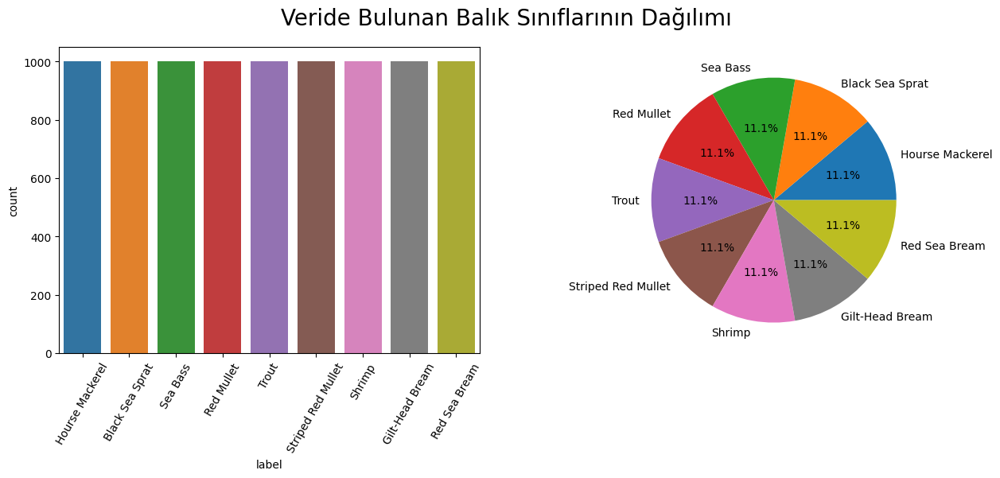

In [9]:
# Her balık çeşidi pasta ve çubuk grafik ile de görelim.
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
sns.countplot(data=data, x='label')
plt.xticks(rotation=60)

# Sınıfların pasta grafiği
plt.subplot(1,2,2)
plt.pie(x=data['label'].value_counts().values,
        labels=data['label'].value_counts().index,
        autopct='%1.1f%%')

# Genel başlık ve gösterim
plt.suptitle('Veride Bulunan Balık Sınıflarının Dağılımı', size=20)
plt.show()

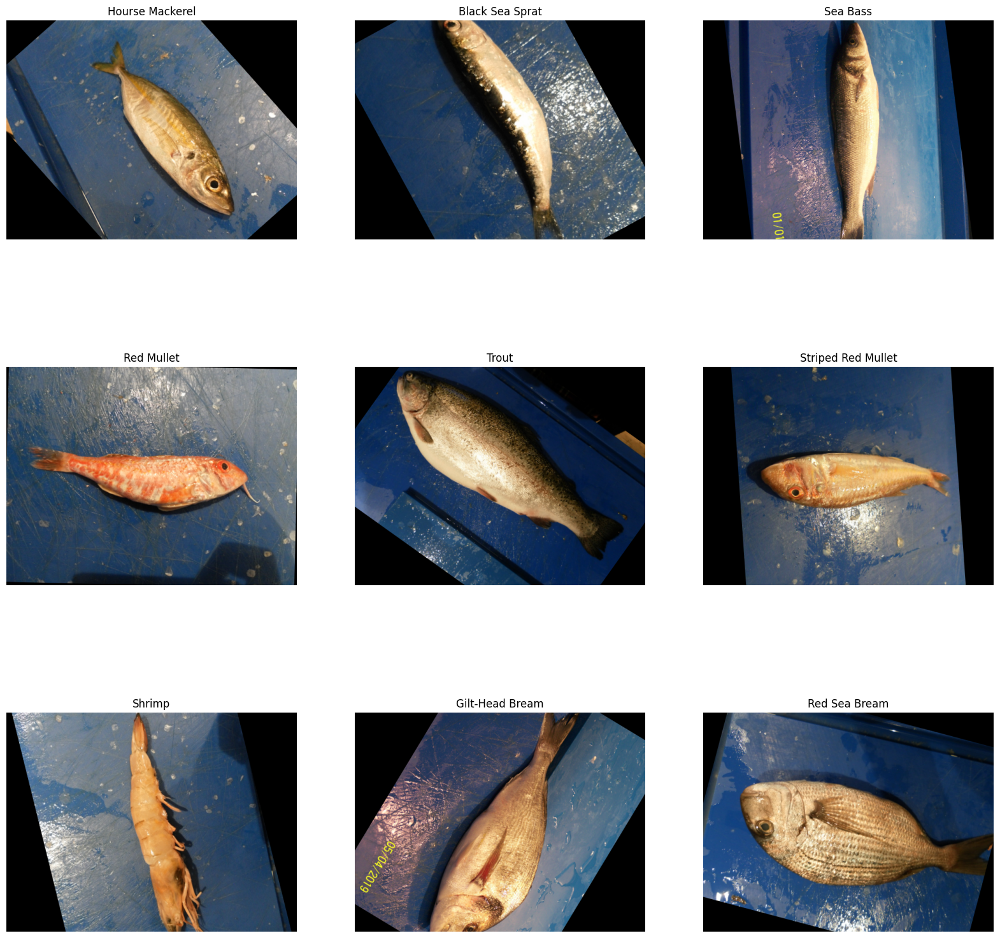

In [10]:
cn = 0
# Figür boyutunu ayarla (20x20 inç)
plt.figure(figsize=(20,20))

# Her bir benzersiz balık türü için döngü
for unique_label in data["label"].unique():
    # 3x3'lük bir grid oluştur ve sırayla her bir hücreye bir görüntü yerleştir
    plt.subplot(3,3,cn+1)
    
    # O balık türüne ait ilk görüntüyü seç ve göster
    plt.imshow(plt.imread(data[data["label"]==unique_label].iloc[0,0]))
    
    # Görüntünün üzerine balık türünün ismini yaz
    plt.title(unique_label)
    
    # Eksenleri gizle
    plt.axis("off")
    
    # Sayacı bir artır
    cn+=1

**NOT:** Bu kod balık veri setindeki her bir türden bir örnek görüntüyü yan yana göstermek için kullanılıyor.

**Bu kod özellikle:**

Veri setini görsel olarak incelemek

Her balık türünden bir örnek görmek

Veri setinin çeşitliliğini anlamak

Görüntü kalitesini kontrol etmek için kullanışlıdır.


Her bir görüntünün üzerinde o balık türünün ismi yazılı olacak ve 3x3'lük bir düzende toplam 9 farklı balık türü gösterilecektir.

## 3.1 - Shrimp -> Karides İlk 4 Görüntüsü

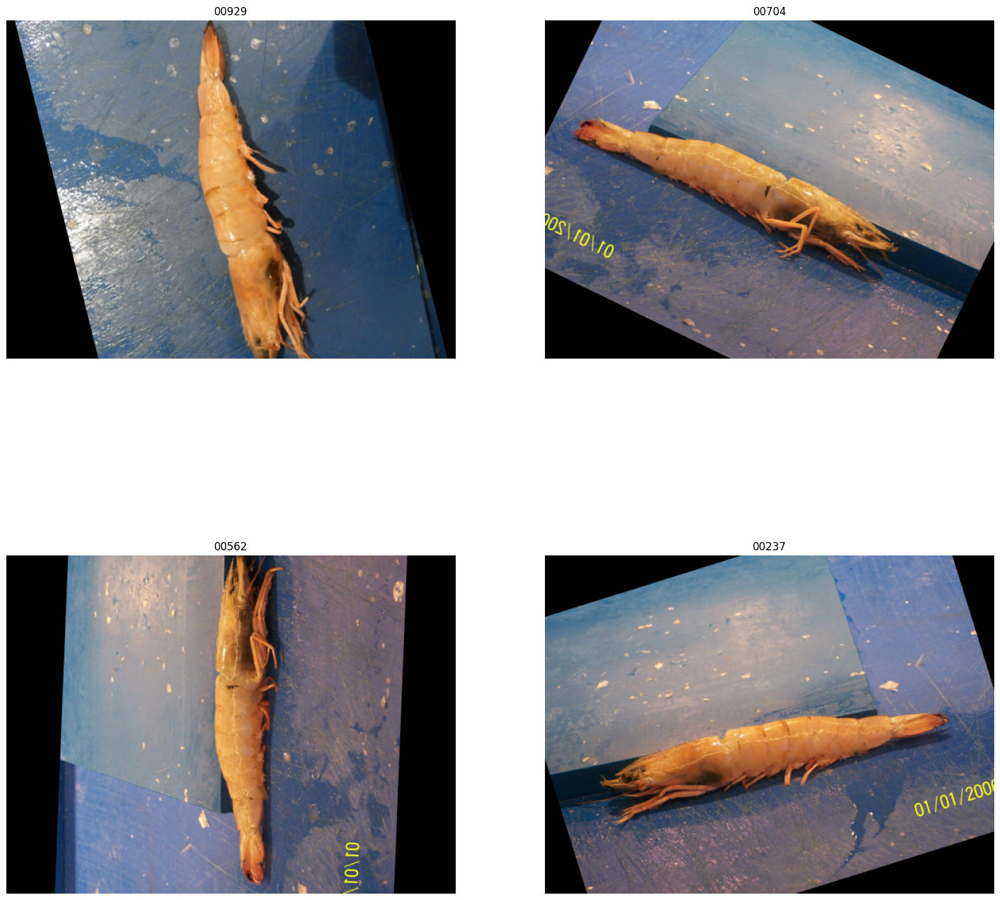

In [11]:
shrimps=data[data["label"]=="Shrimp"].path.iloc[0:4]
cn = 0
plt.figure(figsize=(20,20))
for shrimp in shrimps:
    plt.subplot(int(np.sqrt(len(shrimps))), int(np.sqrt(len(shrimps))),cn+1)
    plt.imshow(plt.imread(shrimp))
    plt.title(shrimp[-9:-4])
    plt.axis("off")
    cn+=1
    

**NOT:** Bu kod balık veri setindeki her bir türden bir örnek görüntüyü yan yana göstermek için kullanılıyor.

## 3.2 - Hourse Mackerel -> İstavrit İlk 4 Görüntüsü

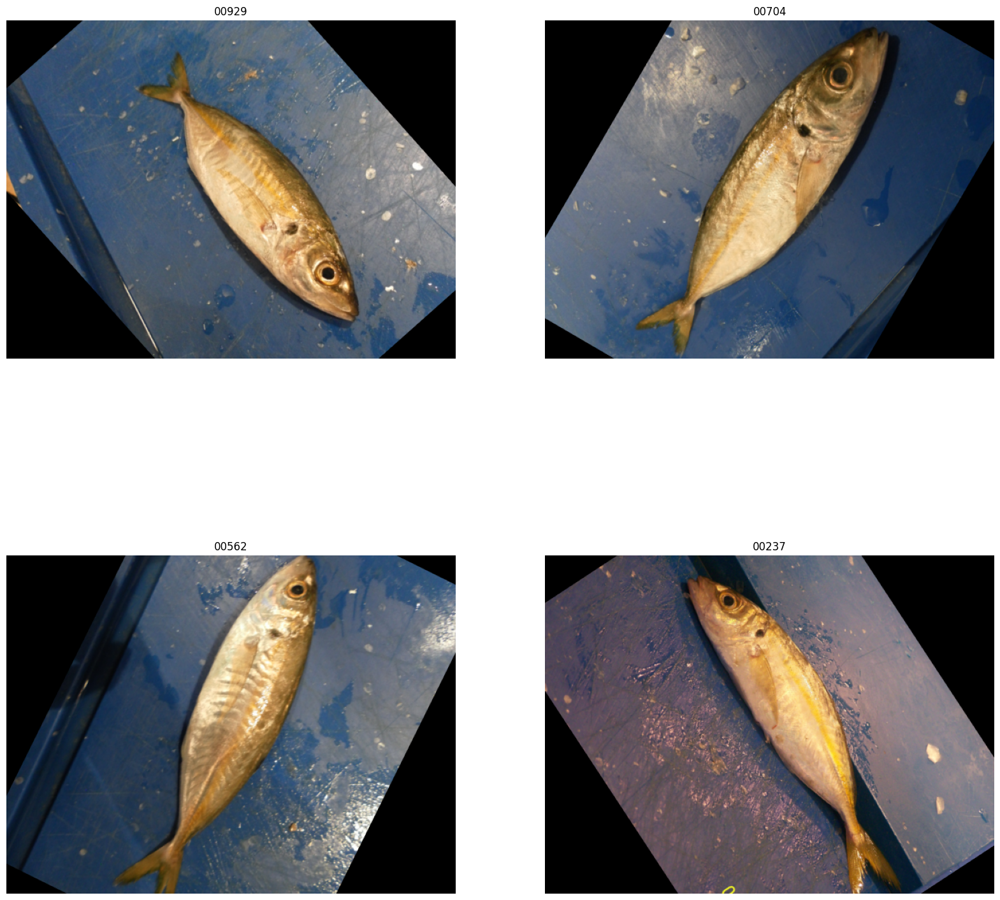

In [12]:
istavritler = data[data["label"]=="Hourse Mackerel"].path.iloc[0:4]
cn = 0
plt.figure(figsize=(20,20))
for istavrit in istavritler:
    plt.subplot(int(np.sqrt(len(istavritler))), int(np.sqrt(len(istavritler))), cn+1)
    plt.imshow(plt.imread(istavrit))
    plt.title(istavrit[-9:-4])
    plt.axis("off")
    cn += 1

## 3.3 - Black Sea Sprat -> Hamsi İlk 4 Görüntüsü

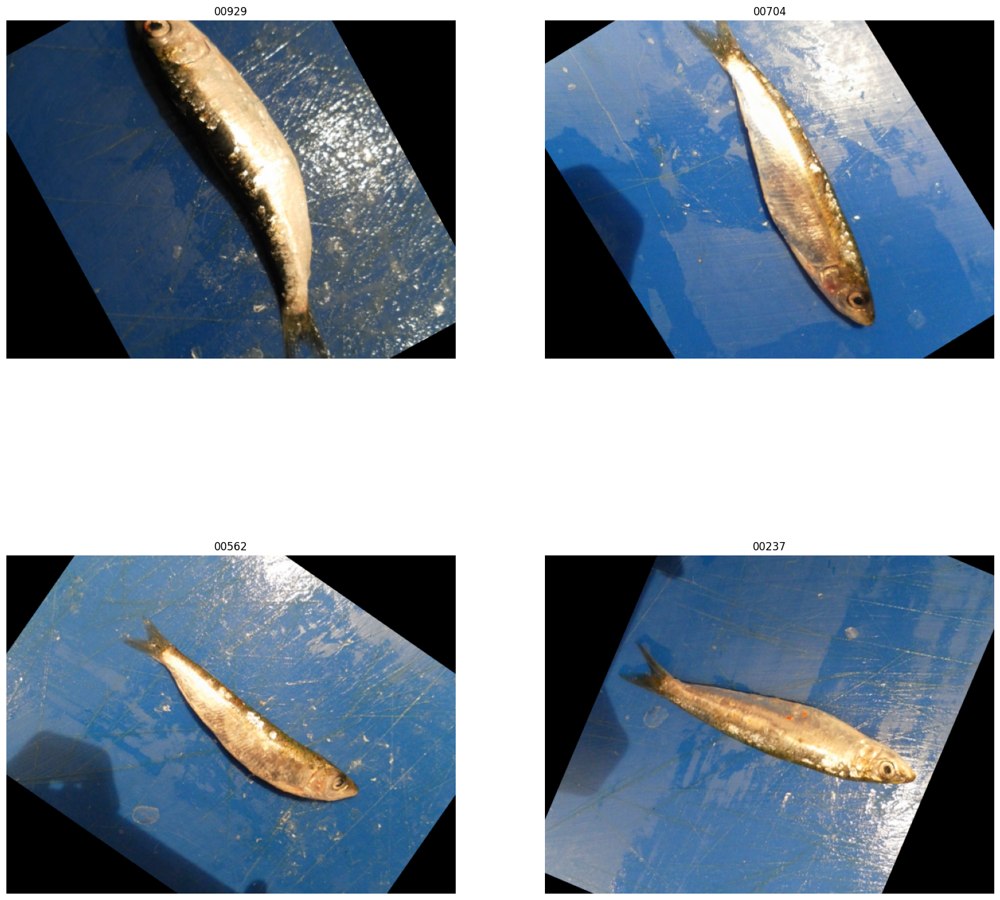

In [13]:
hamsiler = data[data["label"]=="Black Sea Sprat"].path.iloc[0:4]
cn = 0
plt.figure(figsize=(20,20))
for hamsi in hamsiler:
    plt.subplot(int(np.sqrt(len(hamsiler))), int(np.sqrt(len(hamsiler))), cn+1)
    plt.imshow(plt.imread(hamsi))
    plt.title(hamsi[-9:-4])
    plt.axis("off")
    cn += 1

 ### 3.4 -Sea Bass -> Levrek İlk 4 Görüntüsü

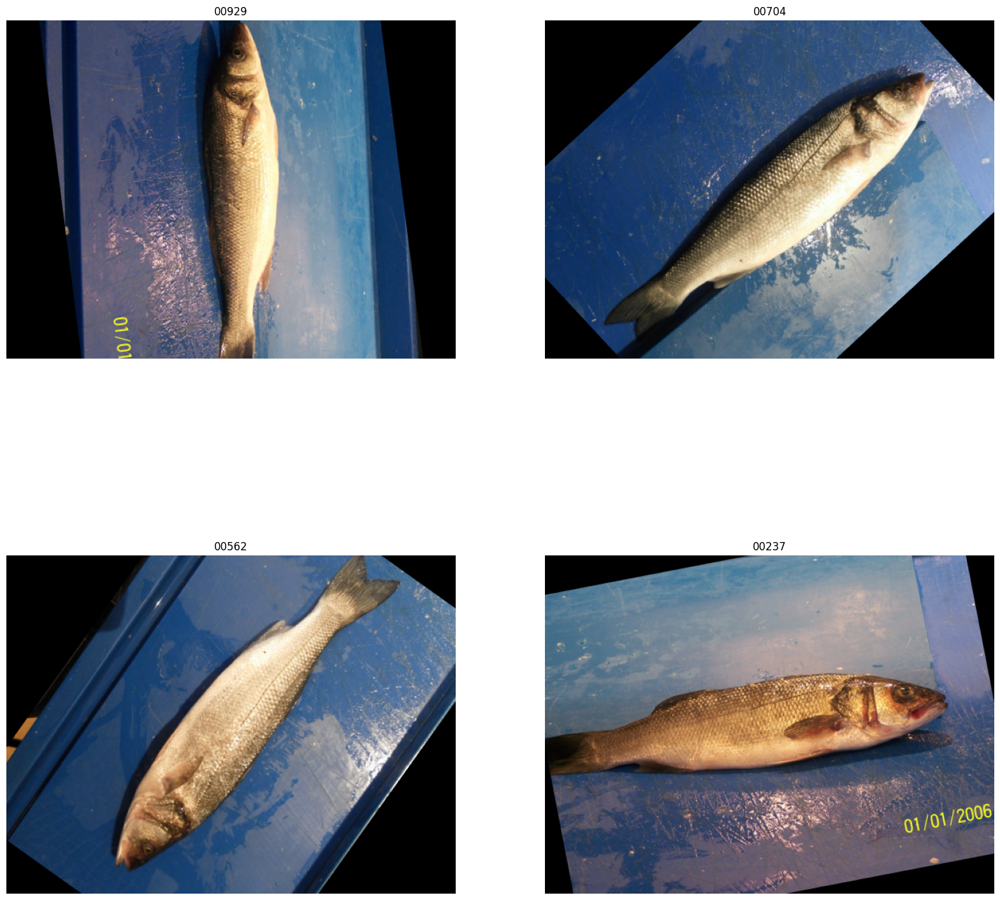

In [14]:
levrekler = data[data["label"]=="Sea Bass"].path.iloc[0:4]
cn = 0
plt.figure(figsize=(20,20))
for levrek in levrekler:
    plt.subplot(int(np.sqrt(len(levrekler))), int(np.sqrt(len(levrekler))), cn+1)
    plt.imshow(plt.imread(levrek))
    plt.title(levrek[-9:-4])
    plt.axis("off")
    cn += 1

## 3.5 - Red Mullet -> Barbun İlk 4 Görüntüsü

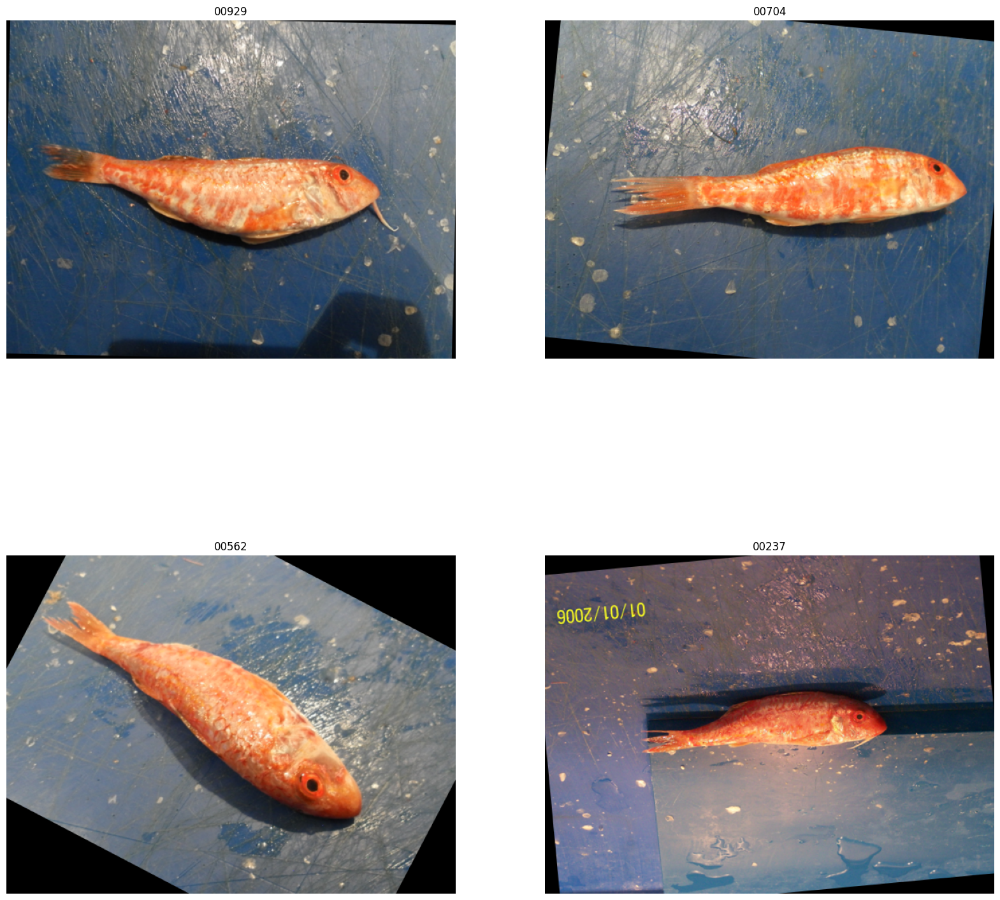

In [15]:
barbunlar = data[data["label"]=="Red Mullet"].path.iloc[0:4]
cn = 0
plt.figure(figsize=(20,20))
for barbun in barbunlar:
    plt.subplot(int(np.sqrt(len(barbunlar))), int(np.sqrt(len(barbunlar))), cn+1)
    plt.imshow(plt.imread(barbun))
    plt.title(barbun[-9:-4])
    plt.axis("off")
    cn += 1

## 3.6 - Trout -> Alabalık İlk 4 Görüntüsü

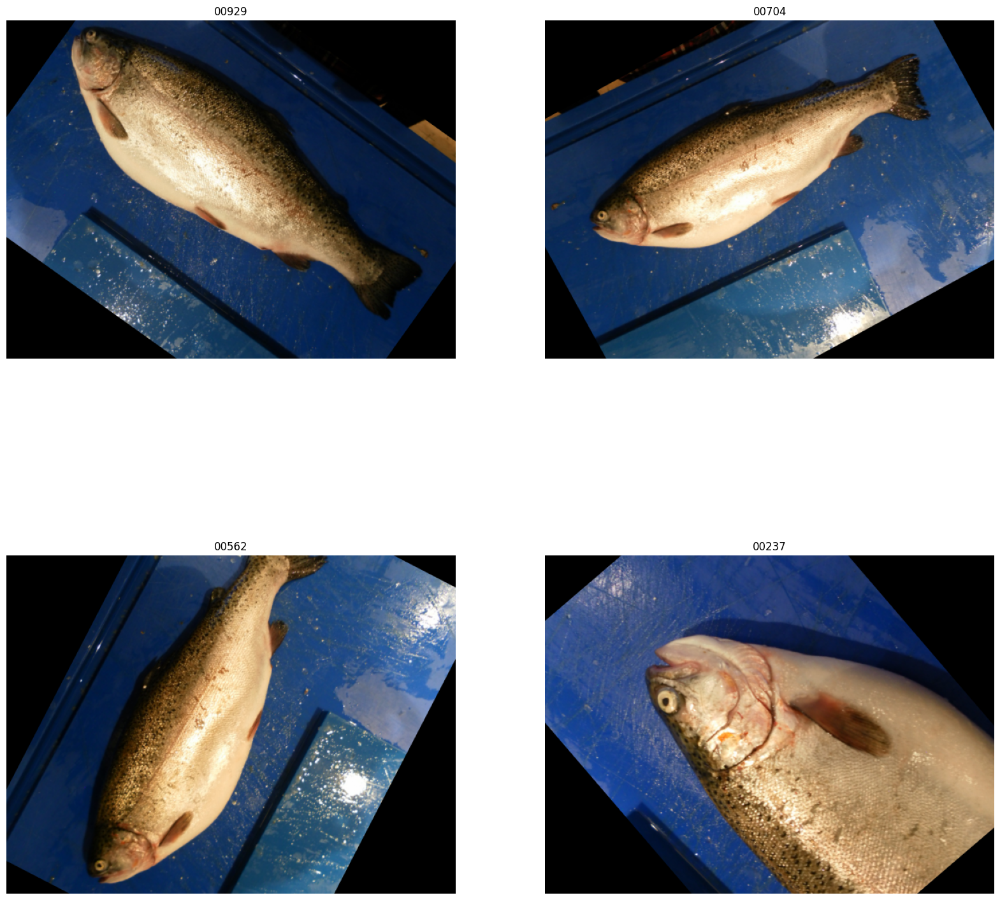

In [16]:
alabalıklar = data[data["label"]=="Trout"].path.iloc[0:4]
cn = 0
plt.figure(figsize=(20,20))
for alabalık in alabalıklar:
    plt.subplot(int(np.sqrt(len(alabalıklar))), int(np.sqrt(len(alabalıklar))), cn+1)
    plt.imshow(plt.imread(alabalık))
    plt.title(alabalık[-9:-4])
    plt.axis("off")
    cn += 1

## 3.7 - Striped Red Mullet -> Tekir İlk 4 Görüntüsü

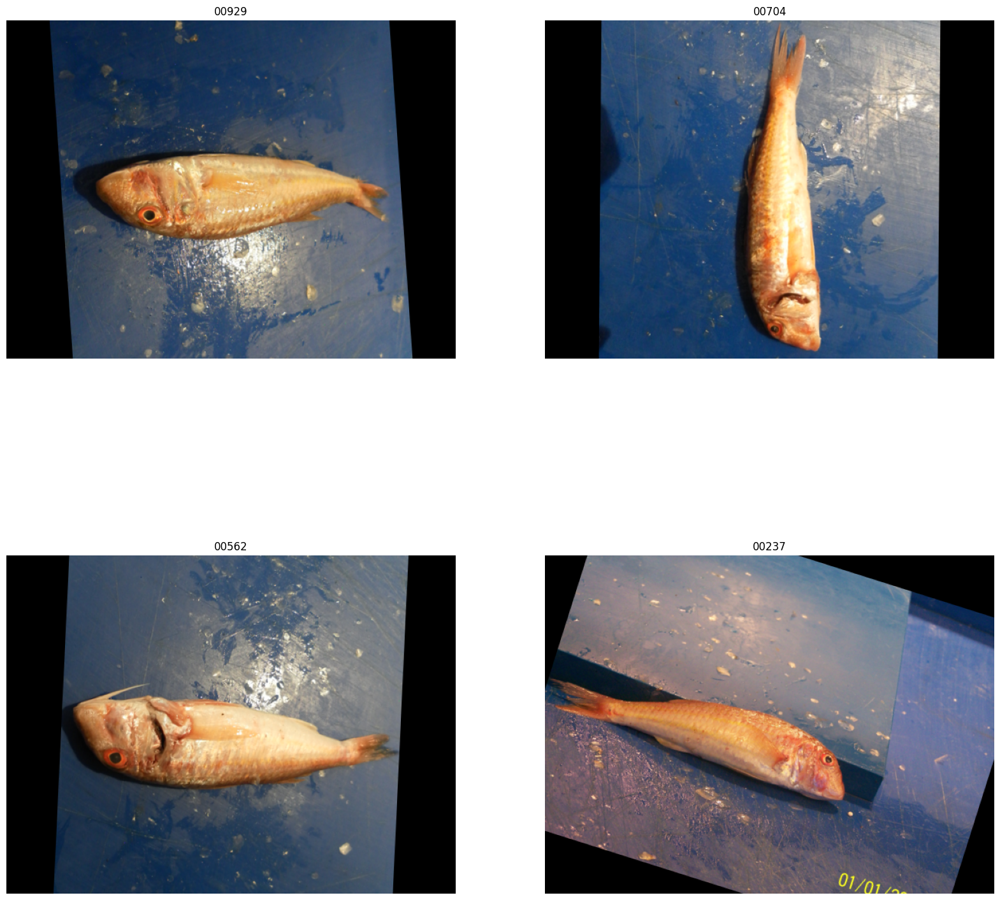

In [17]:
tekirler = data[data["label"]=="Striped Red Mullet"].path.iloc[0:4]
cn = 0
plt.figure(figsize=(20,20))
for tekir in tekirler:
    plt.subplot(int(np.sqrt(len(tekirler))), int(np.sqrt(len(tekirler))), cn+1)
    plt.imshow(plt.imread(tekir))
    plt.title(tekir[-9:-4])
    plt.axis("off")
    cn += 1

## 3.8 - Gilt-Head Bream -> Çipura İlk 4 Görüntüsü

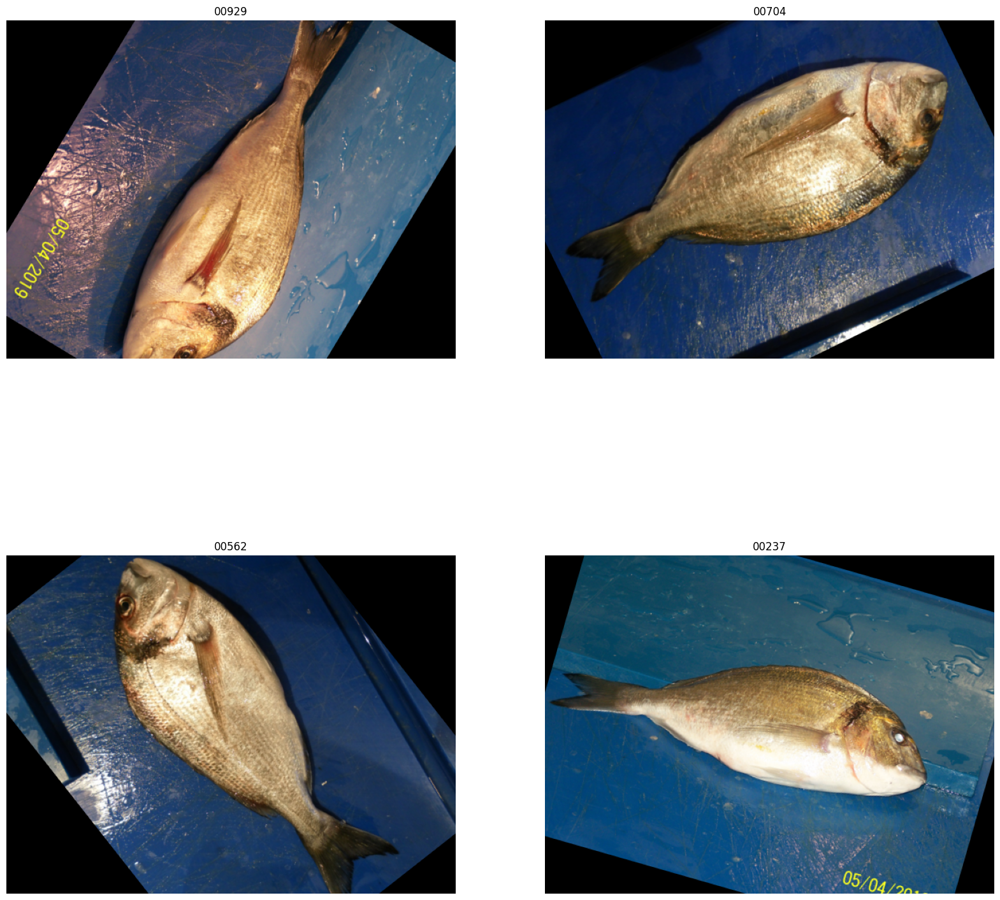

In [18]:
cipuralar = data[data["label"]=="Gilt-Head Bream"].path.iloc[0:4]
cn = 0
plt.figure(figsize=(20,20))
for cipura in cipuralar:
    plt.subplot(int(np.sqrt(len(cipuralar))), int(np.sqrt(len(cipuralar))), cn+1)
    plt.imshow(plt.imread(cipura))
    plt.title(cipura[-9:-4])
    plt.axis("off")
    cn += 1

## 3.9 - Red Sea Bream -> Kırmızı Mercan İlk 4 Görüntüsü

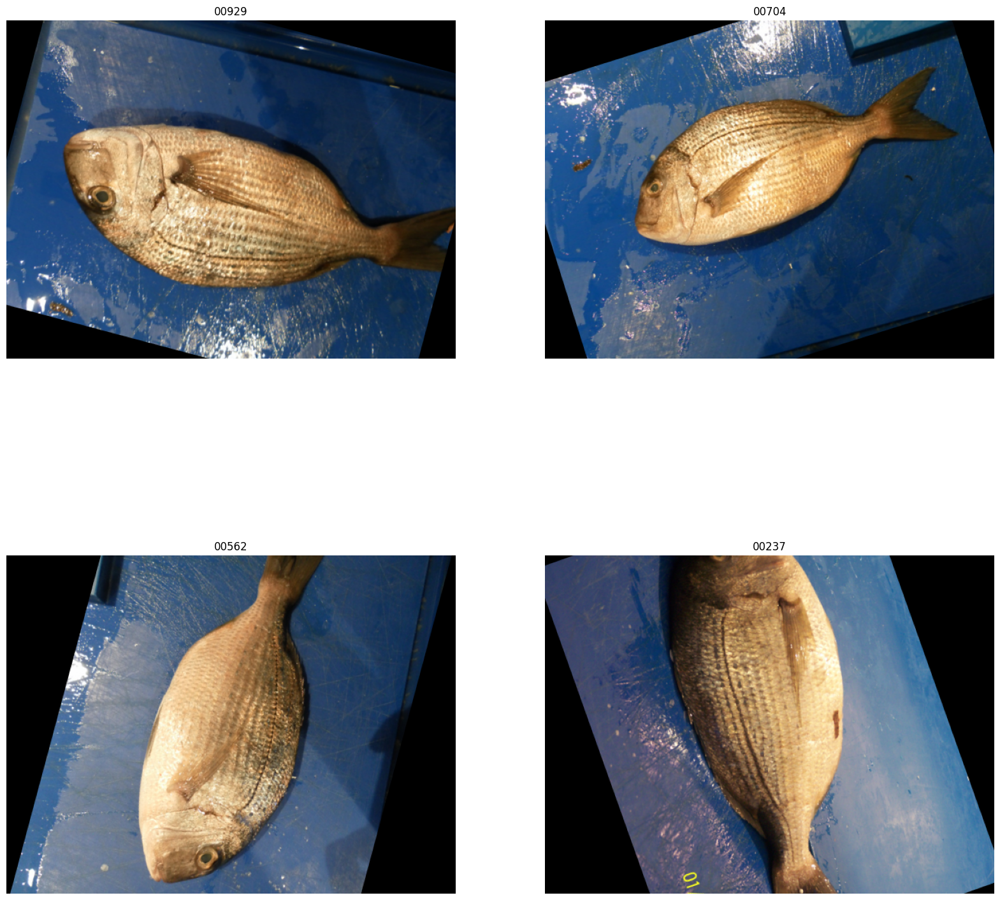

In [19]:
mercanlar = data[data["label"]=="Red Sea Bream"].path.iloc[0:4]
cn = 0
plt.figure(figsize=(20,20))
for mercan in mercanlar:
    plt.subplot(int(np.sqrt(len(mercanlar))), int(np.sqrt(len(mercanlar))), cn+1)
    plt.imshow(plt.imread(mercan))
    plt.title(mercan[-9:-4])
    plt.axis("off")
    cn += 1

# 4 - Veri İşleme (Data Preprocessing)

Veri setinin düzgün bir şekilde eğitilmesi için resimlerin işlenmesi ve hazırlanması gerekir.  

In [20]:
train_data, test_data = train_test_split(data, test_size=0.2, shuffle=True, random_state=42)

In [21]:
print(train_data.shape)
print(test_data.shape)

(7200, 2)
(1800, 2)


**Genel Amaç**

Eğitim için: **train_generator**, modelin eğitim verileri üzerinde veri artırma ve ön işleme yaparak daha çeşitli bir veri seti oluşturur. Ayrıca veriyi eğitim ve doğrulama setlerine ayırır.

Test için: **test_generator***, sadece test verilerini modelin ihtiyaç duyduğu şekilde ön işler, ancak test verileri üzerinde herhangi bir veri artırma yapmaz.

Bu tür jeneratörler büyük veri setleri ile çalışırken oldukça faydalıdır, çünkü veriyi anında yükler ve dönüştürür, bu sayede bellekte çok fazla yer kaplamadan büyük veri setleri ile işlem yapabiliriz.

In [22]:
train_generator = ImageDataGenerator(
    rescale=1./255,
    rotation_range=10,  # Daha geniş döndürme aralığı
    zoom_range=0.1,  # Zoom aralığını arttır
    width_shift_range=0.1,  # Yatay kaydırma
    height_shift_range=0.1,  # Dikey kaydırma
    horizontal_flip=True,  # Yatay çevirme
    fill_mode='constant',  # Boşlukları sabit bir değerle doldurma
    validation_split=0.2    
)

val_generator = ImageDataGenerator(
    rescale=1./255,  # Validation setinde augmentation minimumda tutuluyor
    validation_split=0.2 
)

test_generator = ImageDataGenerator(
    rescale=1./255  # Test setinde augmentasyon yapılmamalıdır
)

**Genel Amaç:**

Bu kod, modelin eğitilmei, doğrulanmaı  ve test  edilmesi için gerekli olan görüntü verilerini dinamik olarak yüklemeye ve işlemeye olanak tanır. Görüntü dosyalarının yolları ve etiketleri DataFrame üzerinden alındığı için, bu yöntem büyük veri setleri ile çalışırken belleği daha verimli kullanmanıza yardımcı olur. Ayrıca, veri artırma ve ön işleme işlemleri, modelin genel performansını artırmak için otomatik olarak uygulanır.

In [23]:
train_images = train_generator.flow_from_dataframe(dataframe=train_data, x_col='path', y_col='label', target_size=(28, 28), color_mode='rgb', class_mode='categorical', batch_size=64, shuffle=True, seed=42, subset='training')
val_images = train_generator.flow_from_dataframe(dataframe=train_data, x_col='path', y_col='label', target_size=(28, 28), color_mode='rgb', class_mode='categorical', batch_size=64, shuffle=True, seed=42, subset='validation' )
test_images = test_generator.flow_from_dataframe(dataframe=test_data, x_col='path', y_col='label', target_size=(28, 28), color_mode='rgb', class_mode='categorical', batch_size=64, shuffle=False )

Found 5760 validated image filenames belonging to 9 classes.
Found 1440 validated image filenames belonging to 9 classes.
Found 1800 validated image filenames belonging to 9 classes.


In [24]:
# Train ve validation için veri akışı ayarları
train_images = train_generator.flow_from_dataframe(
    dataframe=train_data,  # Eğitim verisi
    x_col='path',  # Resim yolları sütunu
    y_col='label',  # Etiket sütunu
    target_size=(28, 28),  # Görüntü boyutu artırıldı
    color_mode='rgb',  # Renkli görüntüler
    class_mode='categorical',  # Çok sınıflı sınıflandırma
    batch_size=32,  # Batch boyutu 32'ye düşürüldü
    shuffle=True,  # Verilerin karıştırılması
    seed=42,  # Reprodüktif sonuçlar için sabit bir tohum değeri
    subset='training'  # Eğitim alt kümesi
)

val_images = train_generator.flow_from_dataframe(
    dataframe=train_data,  # Doğrulama verisi
    x_col='path',
    y_col='label',
    target_size=(28, 28),  # Görüntü boyutu artırıldı
    color_mode='rgb',
    class_mode='categorical',
    batch_size=32,  # Batch boyutu 32
    shuffle=True,
    seed=42,
    subset='validation'  # Validation alt kümesi
)

# Test veri akışı
test_images = test_generator.flow_from_dataframe(
    dataframe=test_data,  # Test verisi
    x_col='path',
    y_col='label',
    target_size=(28, 28),  # Görüntü boyutu artırıldı
    color_mode='rgb',
    class_mode='categorical',
    batch_size=32,  # Testte de aynı batch boyutu kullanılıyor
    shuffle=False  # Test setinde shuffle yapılmaz
)


Found 5760 validated image filenames belonging to 9 classes.
Found 1440 validated image filenames belonging to 9 classes.
Found 1800 validated image filenames belonging to 9 classes.


In [25]:
display(train_images.class_indices)
display(val_images.class_indices)
display(test_images.class_indices)

{'Black Sea Sprat': 0,
 'Gilt-Head Bream': 1,
 'Hourse Mackerel': 2,
 'Red Mullet': 3,
 'Red Sea Bream': 4,
 'Sea Bass': 5,
 'Shrimp': 6,
 'Striped Red Mullet': 7,
 'Trout': 8}

{'Black Sea Sprat': 0,
 'Gilt-Head Bream': 1,
 'Hourse Mackerel': 2,
 'Red Mullet': 3,
 'Red Sea Bream': 4,
 'Sea Bass': 5,
 'Shrimp': 6,
 'Striped Red Mullet': 7,
 'Trout': 8}

{'Black Sea Sprat': 0,
 'Gilt-Head Bream': 1,
 'Hourse Mackerel': 2,
 'Red Mullet': 3,
 'Red Sea Bream': 4,
 'Sea Bass': 5,
 'Shrimp': 6,
 'Striped Red Mullet': 7,
 'Trout': 8}

## 4.1 - Test Verilerin Görselleştirilmesi

Test verisinden alından 6 görüntüyü ve etiketini yan yana görselleştirir. Görüntüler, her biri için etiketleriyle birlikte alt grafiklerde gösterilir. Bu tür bir görselleştirme, modelin tahminlerini ve görüntü verilerini değerlendirmek için oldukça faydalıdır.

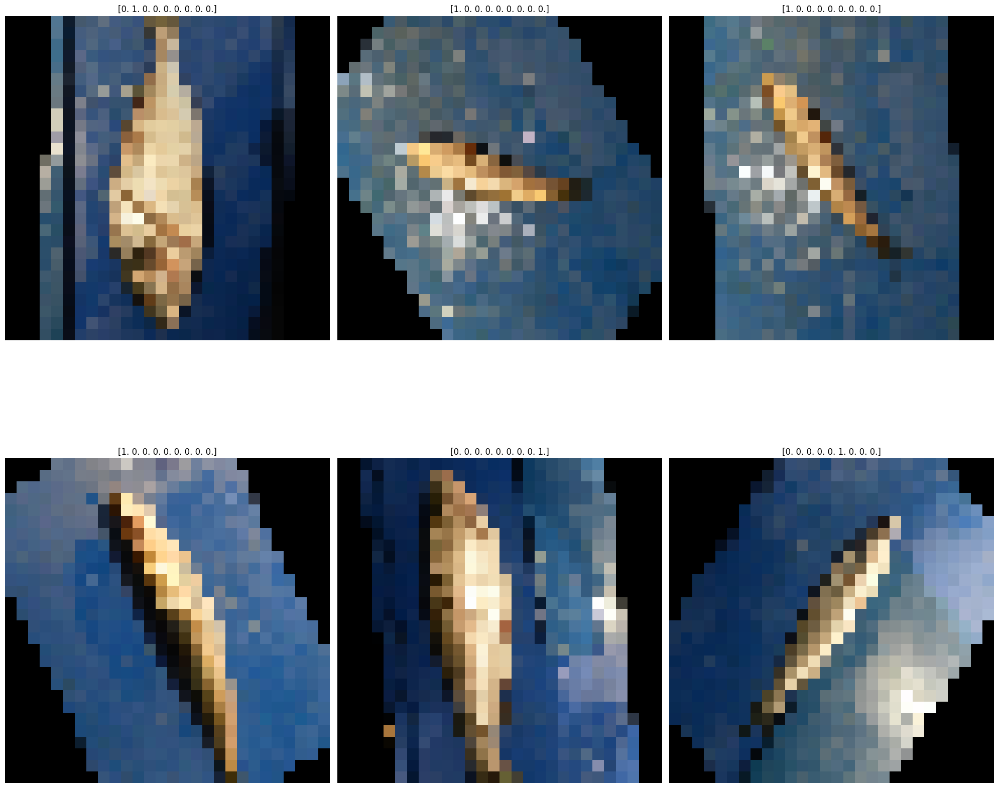

In [26]:
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20,20))
ax = ax.flatten()

for j in range(6):
    img, label = next(test_images)  
    
    
    if isinstance(label, (list, np.ndarray)):
        label = label[0]
    
    if not isinstance(label, str):
        label = str(label)
    
    ax[j].imshow(img[0])  
    ax[j].set_title(label)  
    ax[j].axis('off')

plt.tight_layout()  
plt.show()  

## 4.2 - Train Verilerin Görselleştirilmesi

Train verisinden alından 6 görüntüyü ve etiketini yan yana görselleştirir. Görüntüler, her biri için etiketleriyle birlikte alt grafiklerde gösterilir. Bu tür bir görselleştirme, modelin tahminlerini ve görüntü verilerini değerlendirmek için oldukça faydalıdır.

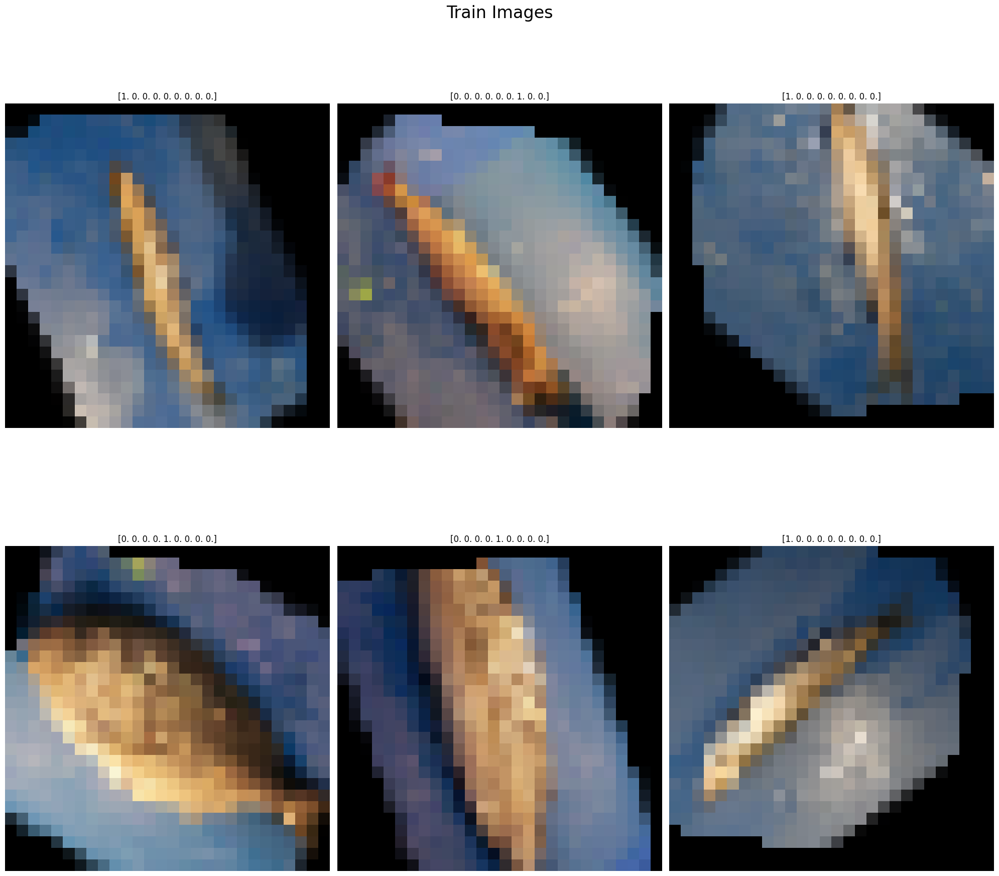

In [27]:
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 20))
ax = ax.flatten()

for j in range(6):
    img, label = next(train_images)  # Eğitim veri kümesinden görüntü ve etiket al

    if isinstance(label, (list, np.ndarray)):
        label = label[0]
    
    if not isinstance(label, str):
        label = str(label)
    
    ax[j].imshow(img[0])  
    ax[j].set_title(label)  
    ax[j].axis('off')

plt.tight_layout()  
plt.suptitle('Train Images', fontsize=24)
plt.show()

## 4.3 - Validation Verilerin Görselleştirilmesi
Validationn verisinden alından 6 görüntüyü ve etiketini yan yana görselleştirir. Görüntüler, her biri için etiketleriyle birlikte alt grafiklerde gösterilir. Bu tür bir görselleştirme, modelin tahminlerini ve görüntü verilerini değerlendirmek için oldukça faydalıdır.

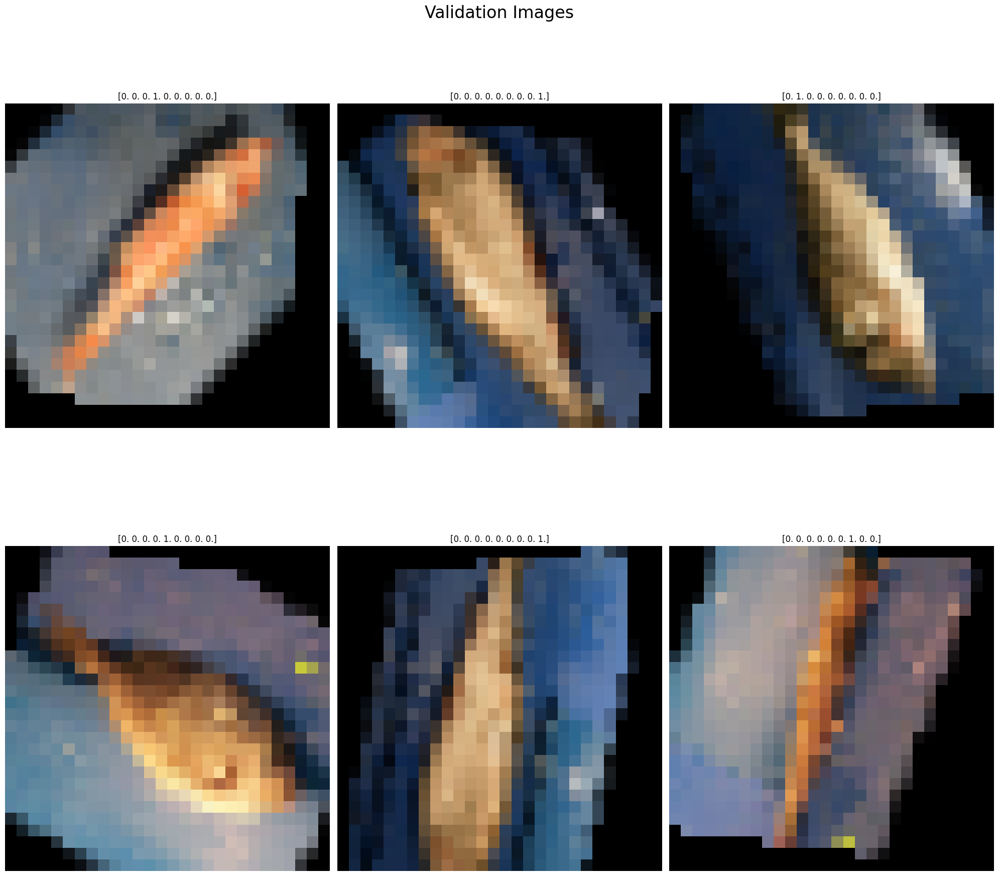

In [28]:
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 20))
ax = ax.flatten()

for j in range(6):
    img, label = next(val_images)  # Doğrulama veri kümesinden görüntü ve etiket al

    if isinstance(label, (list, np.ndarray)):
        label = label[0]
    
    if not isinstance(label, str):
        label = str(label)
    
    ax[j].imshow(img[0])  
    ax[j].set_title(label)  
    ax[j].axis('off')

plt.tight_layout()  
plt.suptitle('Validation Images', fontsize=24)
plt.show()

# 5 - Model Oluşturma

## Model-1

In [29]:
from tensorflow.keras import regularizers

model = tf.keras.models.Sequential()

# Input Layer
model.add(tf.keras.layers.Flatten(input_shape=(28, 28, 3))) 

# Hidden Layer
model.add(tf.keras.layers.Dense(1024, activation='relu', kernel_regularizer=regularizers.l2(0.001)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.4))
model.add(tf.keras.layers.Dense(512, activation='relu', kernel_regularizer=regularizers.l2(0.001)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.4))
model.add(tf.keras.layers.Dense(256, activation='relu', kernel_regularizer=regularizers.l2(0.001)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.4))
model.add(tf.keras.layers.Dense(128, activation='relu', kernel_regularizer=regularizers.l2(0.001)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.4))
model.add(tf.keras.layers.Dense(64, activation='relu', kernel_regularizer=regularizers.l2(0.001)))
model.add(tf.keras.layers.Dropout(0.4))

# Output Layer
model.add(tf.keras.layers.Dense(9, activation='softmax'))

model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ flatten (Flatten)               │ (None, 2352)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1024)           │     2,409,472 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 1024)           │         4,096 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1024)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 512)            │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 9)              │           585 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,115,017 (11.88 MB)

 Trainable params: 3,111,177 (11.87 MB)

 Non-trainable params: 3,840 (15.00 KB)

In [30]:
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=20,
    restore_best_weights=True
)
def lr_scheduler(epoch, lr):
    if epoch >= 25:
        return lr * 0.990
    return lr
lr_scheduler_callback = tf.keras.callbacks.LearningRateScheduler(lr_scheduler)

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), 
    loss='categorical_crossentropy',
    metrics=['accuracy','precision', 'recall', 'F1Score'] )


result = model.fit(
        train_images,
        epochs=100,
        batch_size=64,
        validation_data=val_images,
        callbacks=[early_stopping,lr_scheduler_callback])

Epoch 1/100


I0000 00:00:1729795455.341093      70 service.cc:145] XLA service 0x7a4bfc0078b0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1729795455.341158      70 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0


  1/180 ━━━━━━━━━━━━━━━━━━━━ 50:56 17s/step - F1Score: 0.0361 - accuracy: 0.0625 - loss: 6.5823 - precision: 0.0556 - recall: 0.0312

I0000 00:00:1729795464.401701      70 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


180/180 ━━━━━━━━━━━━━━━━━━━━ 136s 663ms/step - F1Score: 0.1042 - accuracy: 0.1156 - loss: 5.9354 - precision: 0.1193 - recall: 0.0470 - val_F1Score: 0.1170 - val_accuracy: 0.1514 - val_loss: 4.8075 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 1.0000e-04
Epoch 2/100
180/180 ━━━━━━━━━━━━━━━━━━━━ 84s 398ms/step - F1Score: 0.1352 - accuracy: 0.1395 - loss: 5.4815 - precision: 0.1413 - recall: 0.0461 - val_F1Score: 0.2009 - val_accuracy: 0.2361 - val_loss: 4.6399 - val_precision: 0.4038 - val_recall: 0.0146 - learning_rate: 1.0000e-04
Epoch 3/100
180/180 ━━━━━━━━━━━━━━━━━━━━ 82s 399ms/step - F1Score: 0.1613 - accuracy: 0.1644 - loss: 5.2206 - precision: 0.1853 - recall: 0.0527 - val_F1Score: 0.2730 - val_accuracy: 0.2986 - val_loss: 4.4697 - val_precision: 0.4853 - val_recall: 0.0229 - learning_rate: 1.0000e-04
Epoch 4/100
180/180 ━━━━━━━━━━━━━━━━━━━━ 74s 398ms/step - F1Score: 0.1851 - accuracy: 0.1873 - loss: 5.0691 - precision: 0.2375 - recall: 0.0654 - val_F1Scor

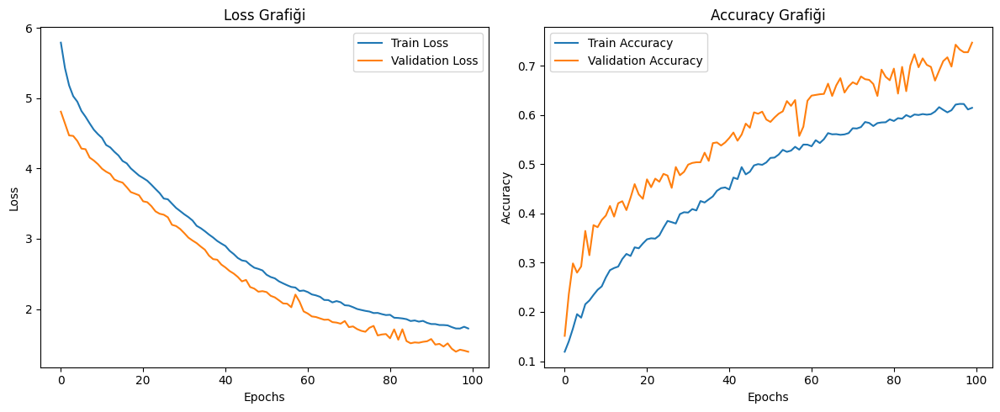

In [31]:
plt.figure(figsize=(12, 5))

# Loss grafiği
plt.subplot(1, 2, 1)
plt.plot(result.history['loss'], label='Train Loss')
plt.plot(result.history['val_loss'], label='Validation Loss')
plt.title('Loss Grafiği')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Accuracy grafiği
plt.subplot(1, 2, 2)
plt.plot(result.history['accuracy'], label='Train Accuracy')
plt.plot(result.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Grafiği')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

# 6 - Model Tahmin

In [32]:
pred = model.predict(test_images)
pred = np.argmax(pred, axis=1)

model.evaluate(test_images)

57/57 ━━━━━━━━━━━━━━━━━━━━ 28s 483ms/step
57/57 ━━━━━━━━━━━━━━━━━━━━ 18s 319ms/step - F1Score: 0.7557 - accuracy: 0.7689 - loss: 1.3097 - precision: 0.8689 - recall: 0.6454


[1.2814276218414307,
 0.7866666913032532,
 0.8768436312675476,
 0.6605555415153503,
 <tf.Tensor: shape=(9,), dtype=float32, numpy=
 array([0.8742004 , 0.67199993, 0.83905005, 0.95979893, 0.84693867,
        0.6055979 , 0.83185834, 0.48101258, 0.87323934], dtype=float32)>]

In [33]:
predict_data=test_data.copy()
labels={}
for l,v in test_images.class_indices.items():
    labels.update({v:l})
predict_data['pred']=pred
predict_data['pred']=predict_data['pred'].apply(lambda x: labels[x])


In [34]:
predict_data=predict_data.reset_index(drop=True)
predict_data.head(10)
predict_data=predict_data.reset_index(drop=True)
predict_data.head(10)


,path,label,pred
0,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Gilt-Head Bream,Gilt-Head Bream
1,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Black Sea Sprat,Black Sea Sprat
2,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Hourse Mackerel,Hourse Mackerel
3,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Trout,Trout
4,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Red Sea Bream,Trout
5,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Red Sea Bream,Gilt-Head Bream
6,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Striped Red Mullet,Striped Red Mullet
7,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Red Sea Bream,Gilt-Head Bream
8,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Red Mullet,Red Mullet
9,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Trout,Trout


In [35]:
predict_data[predict_data['label']!=predict_data['pred']]

,path,label,pred
4,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Red Sea Bream,Trout
5,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Red Sea Bream,Gilt-Head Bream
7,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Red Sea Bream,Gilt-Head Bream
11,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Striped Red Mullet,Hourse Mackerel
19,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Shrimp,Sea Bass
...,...,...,...
1774,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Striped Red Mullet,Shrimp
1785,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Red Sea Bream,Gilt-Head Bream
1790,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Striped Red Mullet,Sea Bass
1791,/kaggle/input/a-large-scale-fish-dataset/Fish_...,Gilt-Head Bream,Trout


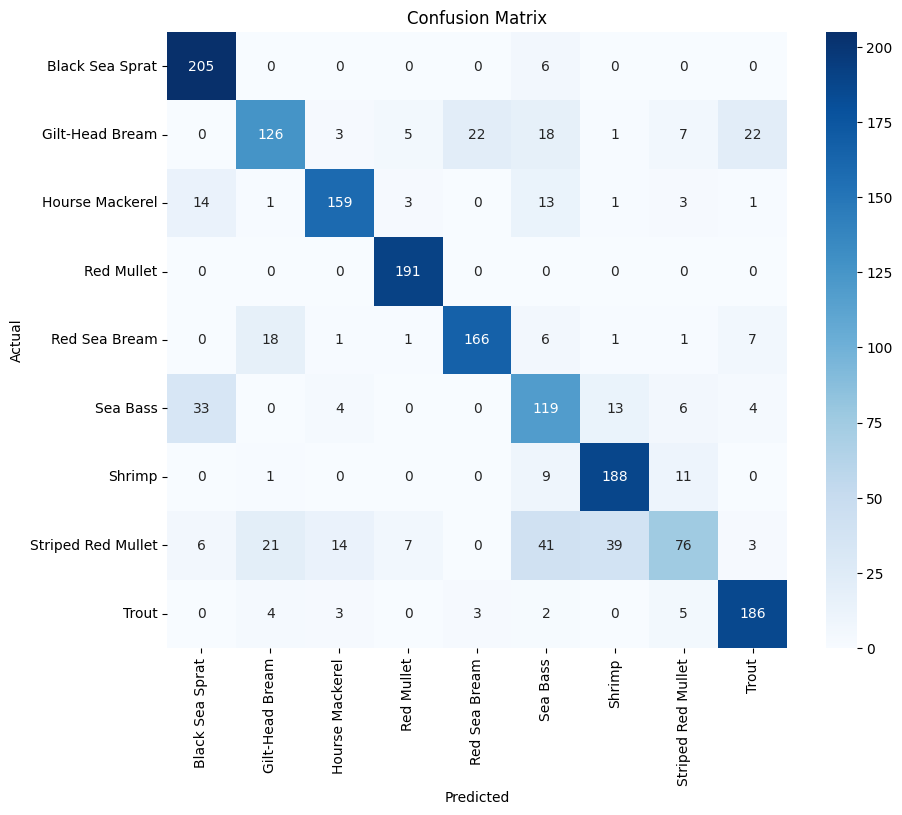

In [36]:
# ### Confusion Matrix and Classification Report
true_classes = test_images.classes
class_labels = list(test_images.class_indices.keys())  

# Confusion Matrix
conf_matrix = confusion_matrix(true_classes, pred )
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_labels, yticklabels=class_labels)
plt.title('Confusion Matrix')
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

In [37]:
report = classification_report(true_classes, pred , target_names=class_labels)
print('Classification Report:')
print(report)

Classification Report:
                    precision    recall  f1-score   support

   Black Sea Sprat       0.79      0.97      0.87       211
   Gilt-Head Bream       0.74      0.62      0.67       204
   Hourse Mackerel       0.86      0.82      0.84       195
        Red Mullet       0.92      1.00      0.96       191
     Red Sea Bream       0.87      0.83      0.85       201
          Sea Bass       0.56      0.66      0.61       179
            Shrimp       0.77      0.90      0.83       209
Striped Red Mullet       0.70      0.37      0.48       207
             Trout       0.83      0.92      0.87       203

          accuracy                           0.79      1800
         macro avg       0.78      0.79      0.78      1800
      weighted avg       0.78      0.79      0.78      1800

